# Visualization

The idea of this notebook is to visualize each column in order to try to understand and try to detect any problem with the data

Summary of main important conclusions:

* 21613 rows
* 20 features (including the label `price`)
* There are several duplicate IDs in the data. The only thing that differs between them is the date and the price. Which means this dataset probably represents house sales, not house ads.
* There are no nulls/NaN.
* The `date` column is probably irrelevant (when it comes to predicting price). We can conclude it is not the date of construction when comparing to the `yr_built` column. 
* `yr_built` - The values range from 1900 to today. It will make it simpler if we used it to compute a `construction_age` feature.
* `yr_renovate` - Non renovated houses are imputed with 0. The best approach here is to convert it into a `renovation_age` feature and pad it to a max value of `construction_age`.
* `zip_code` - Zip code can be treated either as numerical or categorical. 
    * Close zip codes appear to have similar pricing, which can be better captured with the feature as numerical
    * There are however some "fancy" zip codes which are price outliers. This is more likely to be captured as a categorical feature
    * My approach will be to use both (zip code as numerical and categorical) initially when model training. Perhaps using one hot encoding on the top-N expensive/cheapest zip codes?

In [1]:
import pandas as pd
import numpy as np
import time
import datetime
import plotly.express as px
import plotly.graph_objects as go

pd.options.plotting.backend = "plotly"

In [2]:
from pyspark.sql import SparkSession

spark = (
    SparkSession.builder.getOrCreate()
)

2022-12-22 14:09:06,554 WARN util.Utils: Your hostname, laptop-2212 resolves to a loopback address: 127.0.1.1; using 192.168.0.145 instead (on interface wlp3s0)
2022-12-22 14:09:06,555 WARN util.Utils: Set SPARK_LOCAL_IP if you need to bind to another address
2022-12-22 14:09:07,621 WARN util.NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
2022-12-22 14:09:08,828 WARN util.Utils: Service 'SparkUI' could not bind on port 4040. Attempting port 4041.


In [12]:
from pyspark.sql.types import *

df = spark.read.csv("kc_house_data.csv", header=True, inferSchema=True)

In [13]:
from pyspark.sql.functions import col


df.groupby("id").count().filter(col("count") > 2).join(df, "id").show()

+---------+-----+---------------+--------+--------+---------+-----------+--------+------+----------+----+---------+-----+----------+-------------+--------+------------+-------+-------+-------+-------------+----------+
|       id|count|           date|   price|bedrooms|bathrooms|sqft_living|sqft_lot|floors|waterfront|view|condition|grade|sqft_above|sqft_basement|yr_built|yr_renovated|zipcode|    lat|   long|sqft_living15|sqft_lot15|
+---------+-----+---------------+--------+--------+---------+-----------+--------+------+----------+----+---------+-----+----------+-------------+--------+------------+-------+-------+-------+-------------+----------+
|795000620|    3|20140924T000000|115000.0|       3|      1.0|       1080|    6250|   1.0|         0|   0|        2|    5|      1080|            0|    1950|           0|  98168|47.5045|-122.33|         1070|      6250|
|795000620|    3|20141215T000000|124000.0|       3|      1.0|       1080|    6250|   1.0|         0|   0|        2|    5|      1

In [14]:
df = df.toPandas()

* Converting the date string to timestamp to become visualizable

In [15]:
df["date"] = df["date"].map(lambda data_str: datetime.datetime.strptime(data_str, "%Y%m%dT000000"))
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,2014-05-21,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,2015-02-23,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,2014-06-23,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,2015-01-16,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


### Price

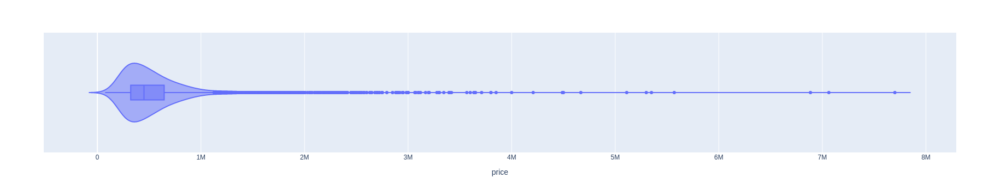

In [16]:
fig = px.violin(df, x="price", box=True)
fig.show()

### Histograms

In [17]:
def plot_hist(df, col, log_of_count, log_of_price, log_of_x_axis=False):
    fig = px.histogram(df, x=col, log_x=log_of_x_axis, log_y=log_of_count)
    fig.show()
    fig = px.histogram(df, x=col, y="price", log_x=log_of_x_axis, log_y=log_of_price, histfunc="avg", color_discrete_sequence=["green"])
    fig.show()

* There's clearly no correlation between the `date` and the prices

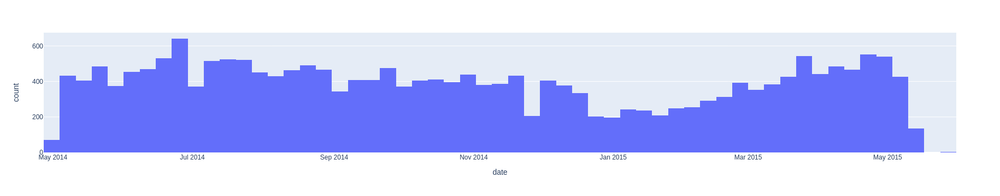

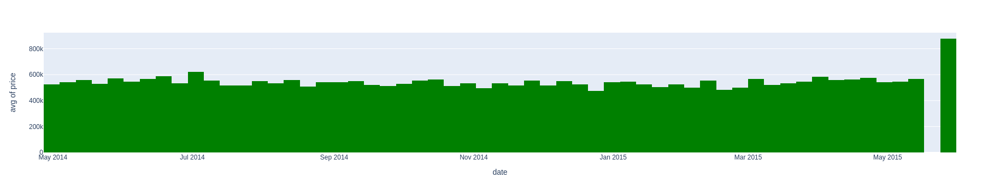

In [18]:
plot_hist(df, "date", log_of_count=False, log_of_price=False)

* There's a clear correlation between number of bedrooms and price. The prices seem to start to go down above 8 bedrooms, but that might also be because the number of rooms are magnitudes lower

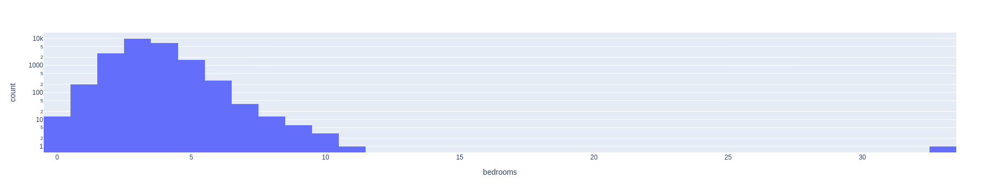

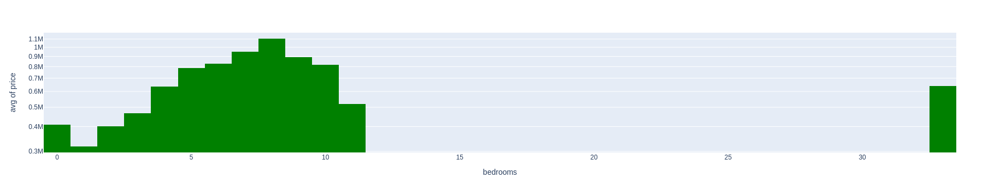

In [19]:
plot_hist(df, "bedrooms", log_of_count=True, log_of_price=True)

* There's something odd with the values of bathrooms. Instead of being integers, there are many rows with decimal values (more than half)
* Still, they are highly correlated with the price, and I don't see any reason to transform them.

In [20]:
# `True`'s are decimal value
df["bathrooms"].map(lambda x: int(x) == x).value_counts()

False    14903
True      6710
Name: bathrooms, dtype: int64

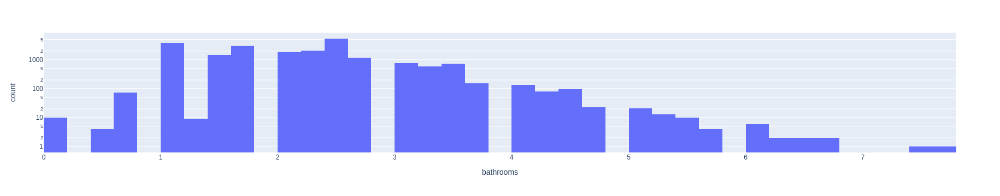

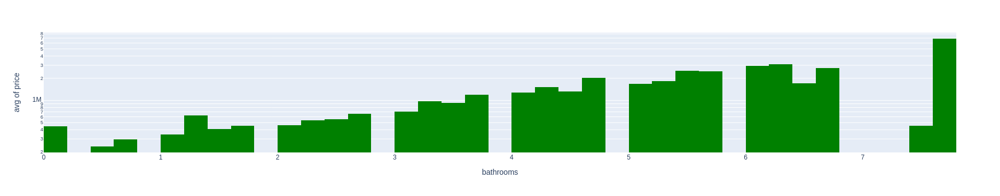

In [21]:
plot_hist(df, "bathrooms", log_of_count=True, log_of_price=True)

* Floor, like bathrooms, has decimal values

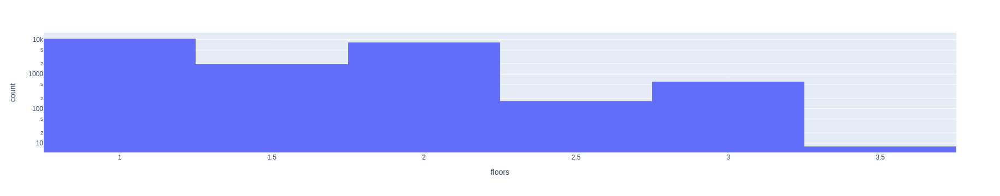

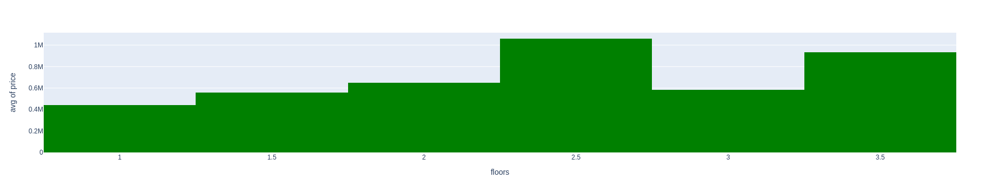

In [22]:
plot_hist(df, "floors", log_of_count=True, log_of_price=False)

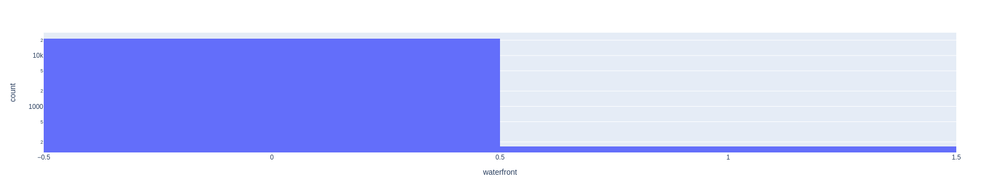

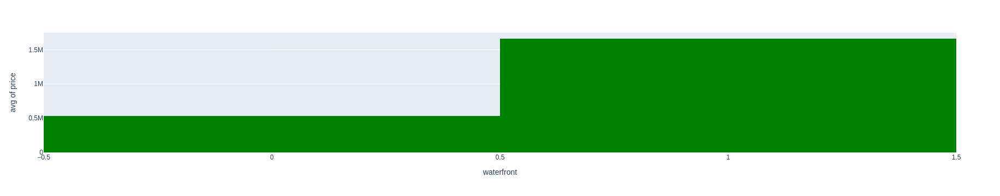

In [23]:
plot_hist(df, "waterfront", log_of_count=True, log_of_price=False)

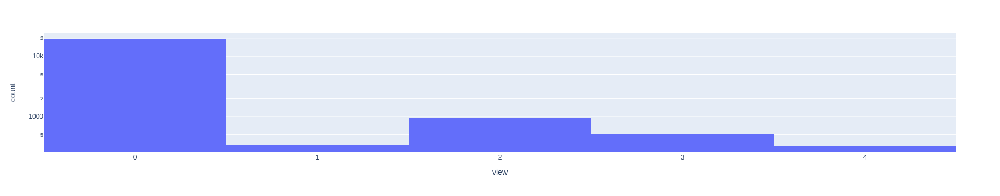

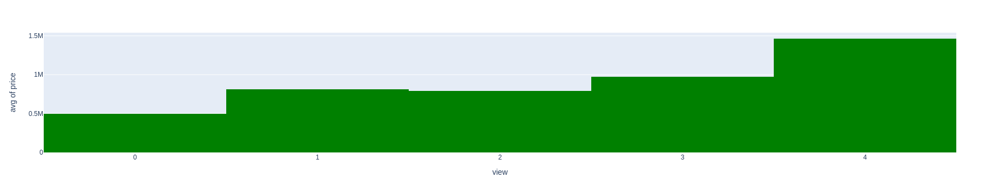

In [24]:
plot_hist(df, "view", log_of_count=True, log_of_price=False)

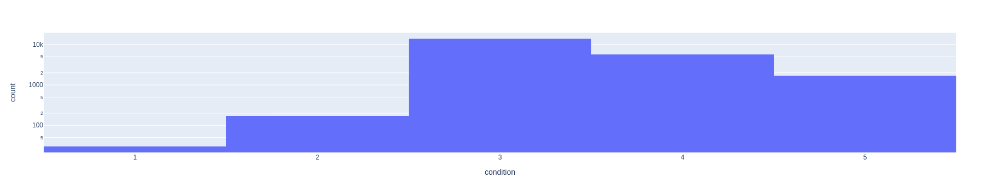

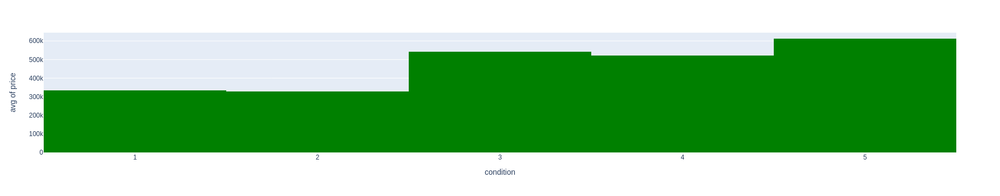

In [25]:
plot_hist(df, "condition", log_of_count=True, log_of_price=False)

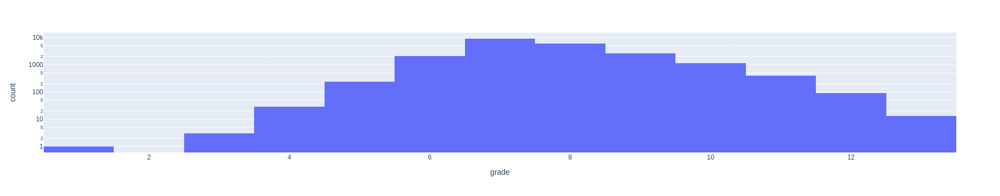

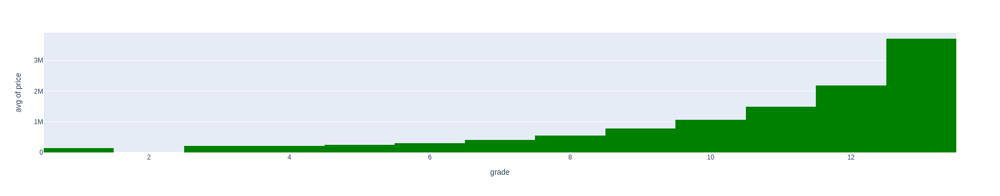

In [26]:
plot_hist(df, "grade", log_of_count=True, log_of_price=False)

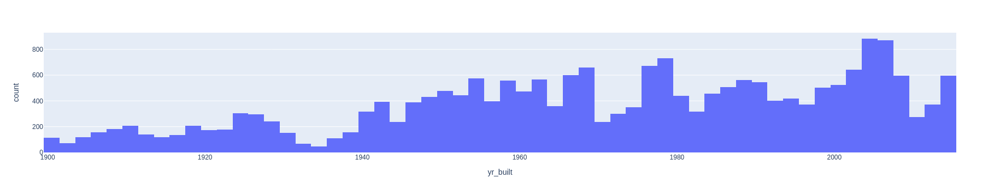

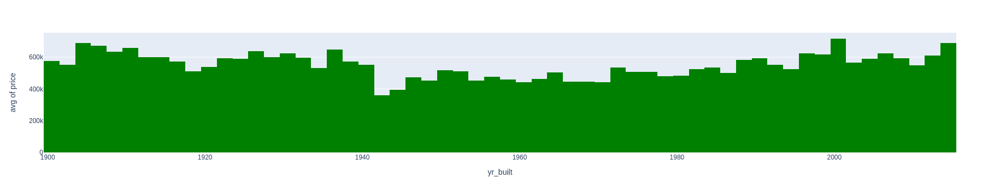

In [27]:
plot_hist(df, "yr_built", log_of_count=False, log_of_price=False)

* There are 12 houses that were sold before being built 

In [28]:
px.histogram(df["date"].map(lambda s: int(s[:4])) - df["yr_built"].astype(int))

TypeError: 'Timestamp' object is not subscriptable

* The yr_renovated feature need be treated

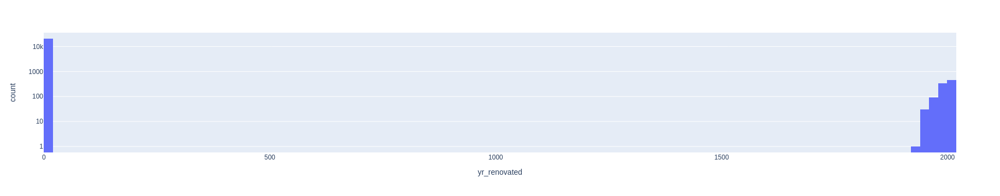

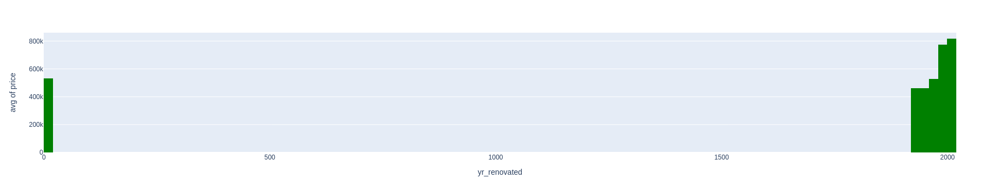

In [29]:
plot_hist(df, "yr_renovated", log_of_count=True, log_of_price=False)

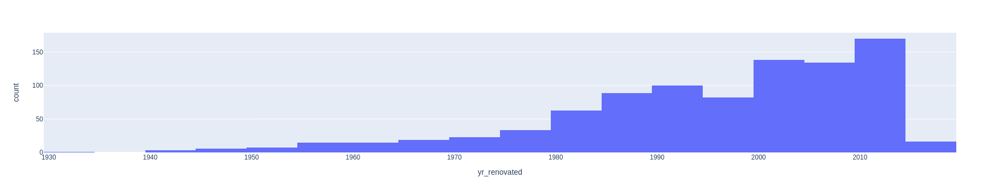

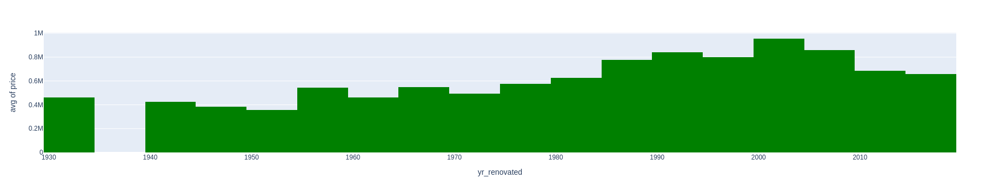

In [30]:
plot_hist(df[df["yr_renovated"] != 0], "yr_renovated", log_of_count=False, log_of_price=False)

* All zipcodes start with `98`.
* When converting them to string, I sorted the dataframe by the zip code so that we can visualize if close zip codes have price similarities. Which is clear there is some.

In [31]:
len(set(df["zipcode"]))

70

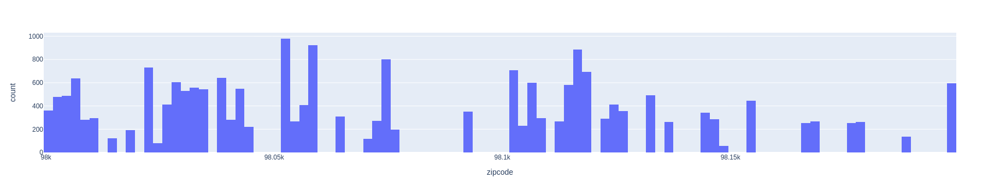

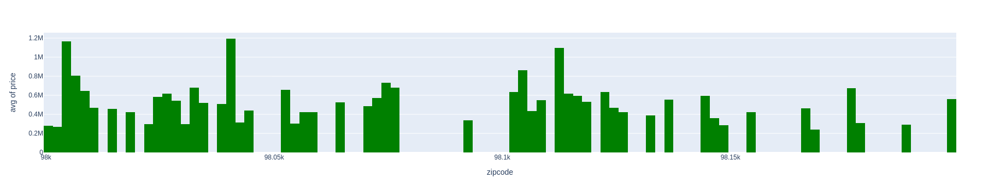

In [32]:
plot_hist(df, "zipcode", log_of_count=False, log_of_price=False)

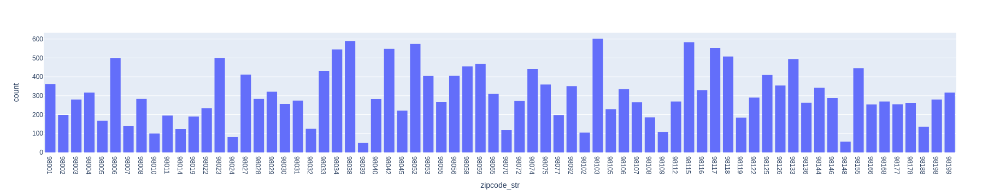

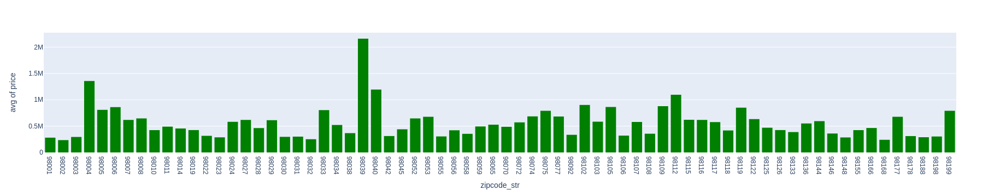

In [33]:
df["zipcode_str"] = df["zipcode"].astype(str)
plot_hist(df.sort_values("zipcode_str"), "zipcode_str", log_of_count=False, log_of_price=False)

## Heatmaps of latitude and longitude

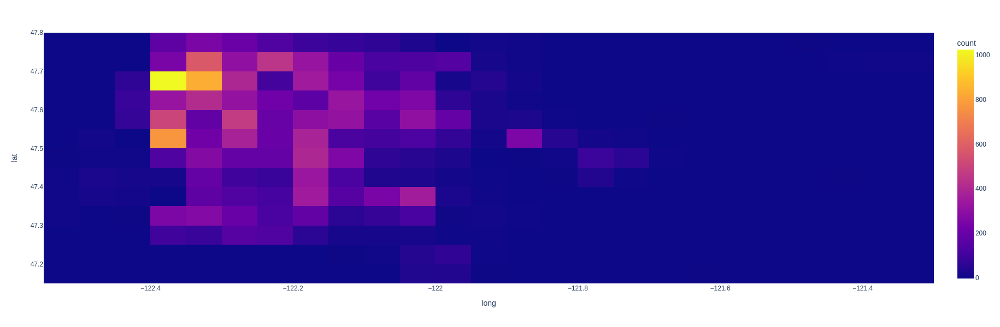

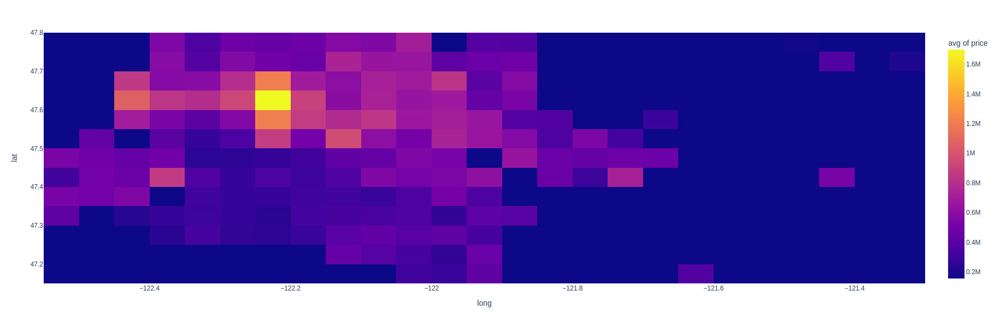

In [34]:
fig = px.density_heatmap(df, x="long", y="lat")
fig.update_layout(
        autosize=False,
        width=700,
        height=600    
    )
fig.show()
fig = px.density_heatmap(df, x="long", y="lat", z="price", histfunc="avg")
fig.update_layout(
        autosize=False,
        width=700,
        height=600    
    )
fig.show()

## Areas
* How can `sqft_lot` be smaller than `sqft_living`? There are 789 occurrences of that
* To visualize the areas of these sparse ranges I will be using scatter plots with non-linear trendlines to visualize correlations

In [35]:
def plot_scatter(col):
    fig = px.scatter(df, x=col, y="price", log_x=True, log_y=True, trendline="lowess", trendline_color_override="red", trendline_options=dict(frac=0.8), opacity=0.7)
    fig.update_layout(
        autosize=False,
        width=700,
        height=700    
    )
    fig.show()

In [36]:
(df["sqft_lot"] <= df["sqft_living"]).sum()

789

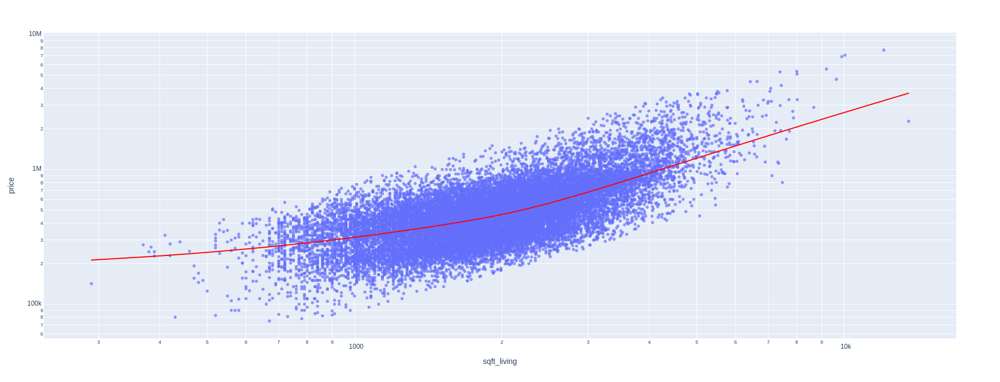

In [37]:
plot_scatter("sqft_living")

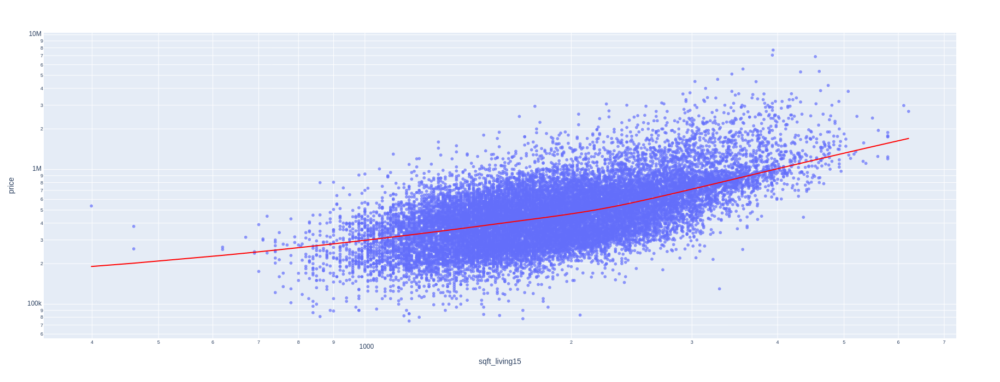

In [38]:
plot_scatter("sqft_living15")

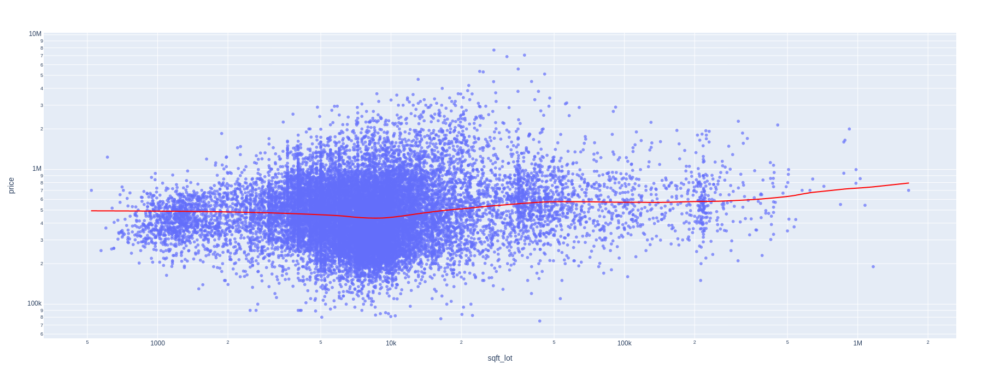

In [39]:
plot_scatter("sqft_lot")

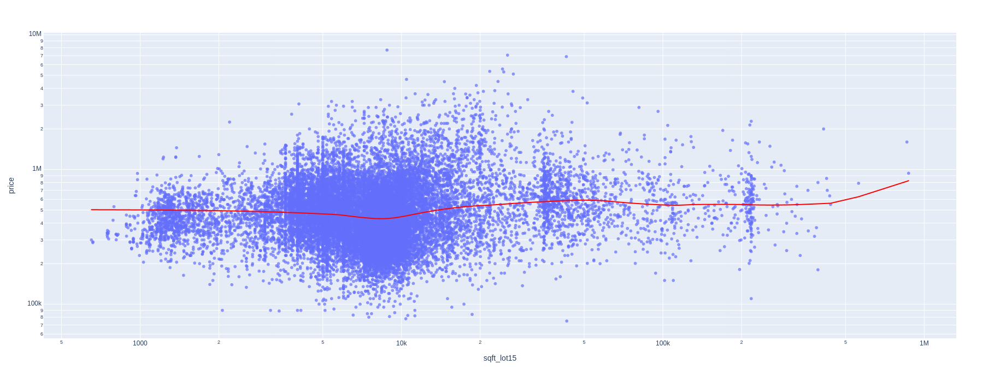

In [40]:
plot_scatter("sqft_lot15")

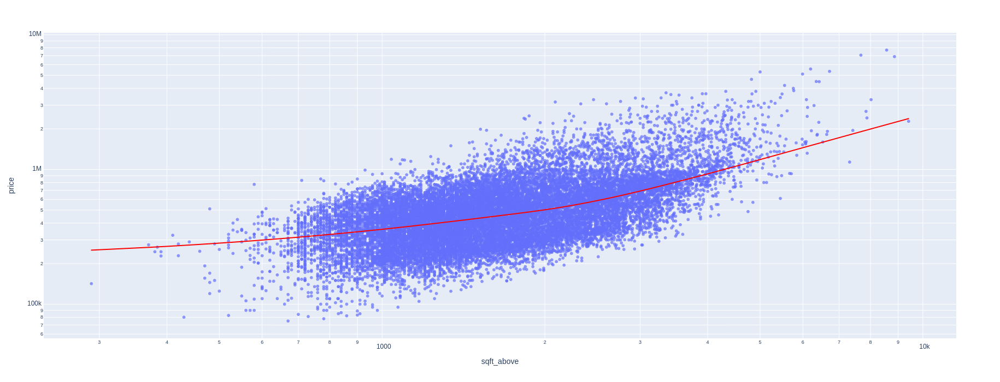

In [41]:
plot_scatter("sqft_above")

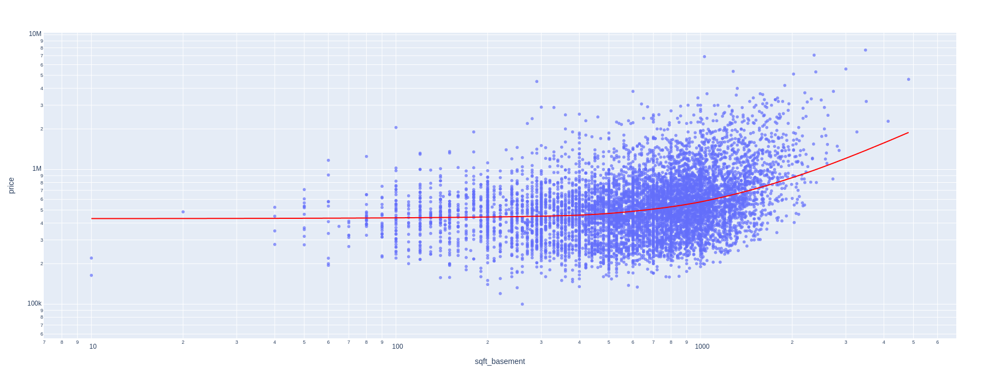

In [42]:
plot_scatter("sqft_basement")